In [9]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import os
from PIL import Image
import requests
from io import BytesIO

In [10]:
!command -v ffmpeg >/dev/null || (apt update && apt install -y ffmpeg)
!pip install -q mediapy
import mediapy as media

# References



1.   Growing Neural Cellular Automata : https://distill.pub/2020/growing-ca/
2.   Learning to Simulate Complex Physics with Graph Networks : https://icml.cc/virtual/2020/poster/6849
3.   ...



# UTILS

In [11]:
hidden_channels = 3
n_channels = 1 + hidden_channels
alpha = 0.01

In [12]:
def grayscale_m(x):
    return x[0,:,:,0]

def rgb_m(x):
    return x[0,:,:,:3]

def plot(x):
    plt.imshow(grayscale_m(x), cmap='Greys')
    plt.show()

def save_plot(x, filename):
    plt.imshow(grayscale_m(x), cmap='Greys')
    plt.savefig(str(filename) + '.png')

def mask_edges(x):
  x[0,0,:,0] = np.zeros(64)
  x[0,:,0,0] = np.zeros(64)
  x[0,:,63,0] = np.zeros(64)
  x[0,63,:,0] = np.zeros(64)
  return x

def get_living_mask(x):
    channel_alpha = x[:, :, :, 0]
    #return tf.nn.max_pool2d(channel_alpha, 3, [1, 1, 1, 1], 'SAME') > alpha
    return np.expand_dims(channel_alpha > alpha, axis=-1)

def modelToGif(model , start_frame , steps , mask=False, rgb=False , fps = 8, hiddenc = True , emb = None):
  x = start_frame
  main_channel = []
  hidden_channel = []
  for i in range(steps):
      if rgb : 
        main_channel.append(np.absolute(x.numpy()[0][:,:,:3]))
        if hiddenc :
          hidden_channel.append(np.absolute(x.numpy()[0][:,:,3:]))
      else: 
        main_channel.append(x.numpy()[0][:,:,0])
        if hiddenc :
          hidden_channel.append(x.numpy()[0][:,:,1:])
      if emb is None:
        x = model(x , mask=mask)
      else :
        x_emb = tf.concat([tf.cast(x,tf.float32) , tf.cast(emb,tf.float32)],-1)
        x = model( x_emb , x , mask= mask)
        
  videos = {
    'main channel': main_channel,
    'hidden channel': hidden_channel,
  }  
  if not hiddenc:
    videos = {
    'main channel': main_channel,
    }

  media.show_videos(videos, height=160, fps=fps, codec='gif', border=True)
  return videos

def datasetToFrames(ds):
  video = []
  _, n, m, c = np.shape(ds[0])
  print(n, n, c)
  for i in ds:
    if c == 1:
      video.append(i[0,:,:,0])
      #video.append(np.concatenate([i[0], i[0], i[0]], axis=2))
    elif c == 2:
      video.append(np.concatenate([i[0], np.zeros((n,m,1))], axis=2))
    else:
      video.append(i[0])
  return video

def toGif(frames):
  media.show_video(frames, height=160, fps=8, codec='gif', border=True)

# Datasets

64 64 1


""

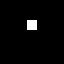

64 64 1


""

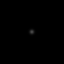

64 64 2


""

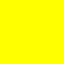

KeyboardInterrupt: 

In [13]:
urlPrefix = 'https://raw.githubusercontent.com/andrinr/dlca-simulation/main/data/export/'
#@title Initialize Training { vertical-output: true}
def getFallingSquareDS():
  dataset = []
  for i in range(60):
    base = np.zeros((1,64,64,1))
    length = 10
    idx , idy = 20,27
    idx += i
    base[:,idx:idx+length,idy:idy+length] = np.ones(1)
    dataset.append(base)
  return dataset

def getDyeDS():
  dataset = []
  for i in range(90):
    filename = f'frame_dye_{i:05d}.png'
    r = requests.get(urlPrefix+filename, stream=True)
    img = tf.keras.preprocessing.image.load_img(BytesIO(r.content), color_mode='grayscale', target_size=(64, 64))
    img = np.expand_dims(np.array(img), axis=2)
    img = tf.expand_dims(img, 0)
    dataset.append(img.numpy())
  return dataset

def getCurlDS():
  dataset = []
  for i in range(90):
    filename = f'frame_curl_{i:05d}.png'
    r = requests.get(urlPrefix+filename, stream=True)
    img = tf.keras.preprocessing.image.load_img(BytesIO(r.content), color_mode='grayscale', target_size=(64, 64))
    img = np.expand_dims(np.array(img), axis=2)
    img = tf.expand_dims(np.array(img), 0) /255
    dataset.append(img.numpy())
  return dataset

def getVelDS():
  dataset = []
  for i in range(90):
    filename = f'frame_vel_{i:05d}.png'
    r = requests.get(urlPrefix+filename, stream=True)
    img = tf.keras.preprocessing.image.load_img(BytesIO(r.content), color_mode='rgb', target_size=(64, 64))
    img = np.array(img)
    img = tf.expand_dims(img, 0)
    dataset.append(img.numpy()[:,:,:,:2])
  return dataset

dsSquareFall = getFallingSquareDS()
toGif(datasetToFrames(dsSquareFall))

dsDye = getDyeDS()
toGif(datasetToFrames(dsDye))

#dsVel = getVelDS()
#toGif(datasetToFrames(dsVel))

#dsCurl = getCurlDS()
#toGif(datasetToFrames(dsCurl))

# Model Neural Cellular Automata

In [14]:
#@title Initialize Training { vertical-output: true}
class NNA(tf.keras.Model):

    def __init__(self, n_channels):
        super().__init__()
        self.channel_n = n_channels
        self.alpha = alpha

        self.dmodel = tf.keras.Sequential([
            tf.keras.layers.Conv2D(128, 1, activation=tf.nn.relu),
            tf.keras.layers.Conv2D(self.channel_n, 1, activation=None, kernel_initializer=tf.zeros_initializer)
        ])
        self(tf.zeros([1, 3, 3, n_channels]))

    def perceive(self, x):
        cellID = tf.constant([[0., 0., 0.], [0., 1., 0.], [0., 0., 0.]], dtype=tf.float32)
        sobelX = tf.constant([[-1., 0., 1.], [-2., 0., 2.], [-1., 0., 1.]], dtype=tf.float32)
        sobelY = tf.constant([[-1., -2., -1.], [0., 0., 0.], [1., 2., 1.]], dtype=tf.float32)

        kernel = tf.stack([cellID, sobelX, sobelY], -1)[:, :, None, :]
        kernel = tf.repeat(kernel, self.channel_n, 2)

        y = tf.nn.depthwise_conv2d(x, kernel, [1, 1, 1, 1], 'SAME')
        return y

    def call(self, x, steps = 1 , mask = False):
        if mask:
          pre_live_mask = get_living_mask(x)

        y = self.perceive(x)
        dx = self.dmodel(y) * steps

        update_mask = tf.random.uniform(tf.shape(x[:, :, :, :1])) <= 0.5
        x += dx * tf.cast(update_mask, tf.float32)

        if mask:
          post_life_mask = get_living_mask(x)
          life_mask = pre_live_mask | post_life_mask
          life_mask = mask_edges(life_mask)
          return x * tf.cast(life_mask, tf.float32)

        return x

model = NNA(n_channels)
model.summary()

Model: "nna"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential (Sequential)     (1, 3, 3, 4)              2180      
                                                                 
Total params: 2,180
Trainable params: 2,180
Non-trainable params: 0
_________________________________________________________________


# Start simple, moving the square

In [15]:
dataset = dsSquareFall

lr = 2e-03
lr_sched = tf.keras.optimizers.schedules.PiecewiseConstantDecay([1000], [lr, lr*0.05])
optimizer = tf.keras.optimizers.Adam(lr_sched)
loss_object = tf.keras.losses.MeanSquaredError()

start_frame = 0
end_frame = len(dataset)-1
max_frame_steps = 10
extra_steps = 10

Epoch 0 , Loss 216.064453125


main channel,hidden channel

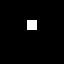
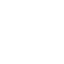

Epoch 100 , Loss 67.270263671875


main channel,hidden channel

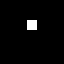
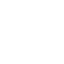

Epoch 200 , Loss 61.24732208251953


main channel,hidden channel

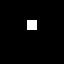
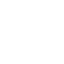

In [16]:
model = NNA(n_channels)
dataset = dsSquareFall
init = tf.convert_to_tensor(np.concatenate((dataset[start_frame],np.ones((1,64,64,hidden_channels))) , axis = -1))

#@title Loss frame by frame { vertical-output: true}
def train_step_frame_at_a_time(dataset):
    loss = 0
    x = init
    with tf.GradientTape() as g:        
        for i in tf.range(start_frame, end_frame):
              x = model(x)
              loss += loss_object(grayscale_m(dataset[i+1]), grayscale_m(x)) * 100
    gradients = g.gradient(loss, model.weights)
    gradients = [g / (tf.norm(g) + 1e-8) for g in gradients]
    optimizer.apply_gradients(zip(gradients, model.weights))
    return x, loss

EPOCHS = 501
losses = []
for epoch in range(EPOCHS):
    x, loss = train_step_frame_at_a_time(dataset)
    losses.append(loss)
    if epoch % 100 == 0:
      print(f'Epoch {epoch} , Loss {loss}')
      modelToGif(model, init ,50)

plt.plot(losses)
plt.title("Loss per epoch")
plt.show()

Epoch 0 , Loss 26.85546875


main channel,hidden channel

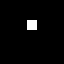
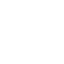

Epoch 100 , Loss 2.596217155456543


main channel,hidden channel

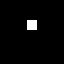
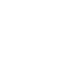

Epoch 200 , Loss 2.0703835487365723


main channel,hidden channel

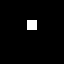
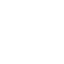

Epoch 300 , Loss 1.8696660995483398


main channel,hidden channel

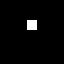
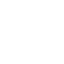

Epoch 400 , Loss 1.6162015199661255


main channel,hidden channel

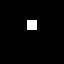
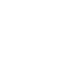

Epoch 500 , Loss 1.1180130243301392


main channel,hidden channel

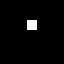
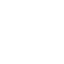

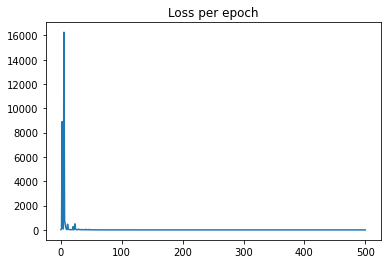

In [ ]:
model = NNA(n_channels)
dataset = dsSquareFall
init = tf.convert_to_tensor(np.concatenate((dataset[start_frame],np.ones((1,64,64,hidden_channels))) , axis = -1))

#@title Loss frame + 10 extra steps { vertical-output: true}
def train_step_frame_at_a_time(dataset):
    loss = 0
    extra_step = 10
    x = init
    with tf.GradientTape() as g:        
        for i in tf.range(start_frame, 10):
              for j in range(extra_step):
                  x = model(x)
              loss += loss_object(grayscale_m(dataset[i+1]), grayscale_m(x)) * 100
    gradients = g.gradient(loss, model.weights)
    gradients = [g / (tf.norm(g) + 1e-8) for g in gradients]
    optimizer.apply_gradients(zip(gradients, model.weights))
    return x, loss

EPOCHS = 501
losses = []
for epoch in range(EPOCHS):
    x, loss = train_step_frame_at_a_time(dataset)
    losses.append(loss)
    if epoch % 100 == 0:
      print(f'Epoch {epoch} , Loss {loss}')
      modelToGif(model, init ,500)

plt.plot(losses)
plt.title("Loss per epoch")
plt.show()

Epoch 0 , Loss 26.85546875


main channel,hidden channel

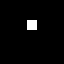
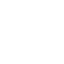

Epoch 100 , Loss 1.5413670539855957


main channel,hidden channel

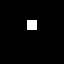
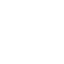

Epoch 200 , Loss 1.7038575410842896


main channel,hidden channel

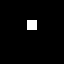
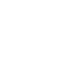

Epoch 300 , Loss 1.745009183883667


main channel,hidden channel

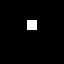
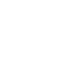

Epoch 400 , Loss 1.6438000202178955


main channel,hidden channel

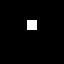
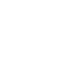

Epoch 500 , Loss 1.5995314121246338


main channel,hidden channel

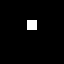
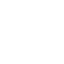

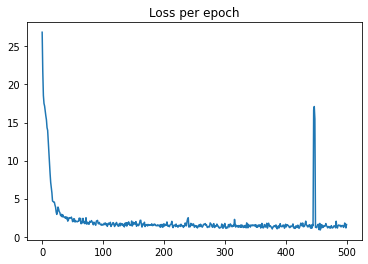

In [ ]:
model = NNA(n_channels)
dataset = dsSquareFall

init = tf.convert_to_tensor(np.concatenate((dataset[start_frame],np.ones((1,64,64,hidden_channels))) , axis = -1))

#@title Loss frame + masking + 10 extra steps { vertical-output: true}
def train_step_frame_at_a_time(dataset):
    loss = 0
    extra_step = 10
    x = init
    with tf.GradientTape() as g:        
        for i in tf.range(start_frame, 10):
              for j in range(extra_step):
                  x = model(x , mask=True)
              loss += loss_object(grayscale_m(dataset[i+1]), grayscale_m(x)) * 100
    gradients = g.gradient(loss, model.weights)
    gradients = [g / (tf.norm(g) + 1e-8) for g in gradients]
    optimizer.apply_gradients(zip(gradients, model.weights))
    return x, loss

EPOCHS = 501
losses = []
for epoch in range(EPOCHS):
    x, loss = train_step_frame_at_a_time(dataset)
    losses.append(loss)
    if epoch % 100 == 0:
      print(f'Epoch {epoch} , Loss {loss}')
      modelToGif(model, init , 500 , mask=True)

plt.plot(losses)
plt.title("Loss per epoch")
plt.show()

Epoch 0 , Loss 26.85546875


main channel

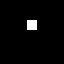

Epoch 100 , Loss 2.3457865715026855


main channel

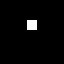

Epoch 200 , Loss 2.244684934616089


main channel

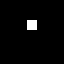

Epoch 300 , Loss 1.7655811309814453


main channel

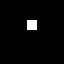

Epoch 400 , Loss 0.9335220456123352


main channel

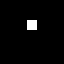

Epoch 500 , Loss 1.2642161846160889


main channel

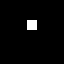

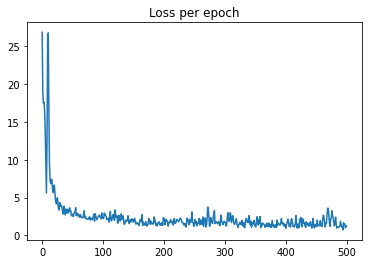

In [ ]:
model = NNA(1)
dataset = dsSquareFall

init = tf.convert_to_tensor(dataset[start_frame])

#@title Loss frame + masking + 10 extra steps + no hidden channels { vertical-output: true}
def train_step_frame_at_a_time(dataset):
    loss = 0
    extra_step = 10
    x = init
    with tf.GradientTape() as g:        
        for i in tf.range(start_frame, 10):
              for j in range(extra_step):
                  x = model(x , mask=True)
              loss += loss_object(grayscale_m(dataset[i+1]), grayscale_m(x)) * 100
    gradients = g.gradient(loss, model.weights)
    gradients = [g / (tf.norm(g) + 1e-8) for g in gradients]
    optimizer.apply_gradients(zip(gradients, model.weights))
    return x, loss

EPOCHS = 501
losses = []
for epoch in range(EPOCHS):
    x, loss = train_step_frame_at_a_time(dataset)
    losses.append(loss)
    if epoch % 100 == 0:
      print(f'Epoch {epoch} , Loss {loss}')
      modelToGif(model, init , 500 , mask=True)

plt.plot(losses)
plt.title("Loss per epoch")
plt.show()

# Sim

Epoch 0 , Loss 46.603759765625


main channel,hidden channel

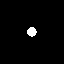
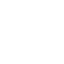

Epoch 100 , Loss 197.4551239013672


main channel,hidden channel

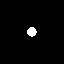
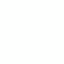

Epoch 200 , Loss 227.2265167236328


main channel,hidden channel

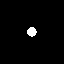
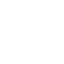

Epoch 300 , Loss 33.32061004638672


main channel,hidden channel

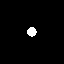
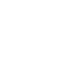

Epoch 400 , Loss 14.811127662658691


main channel,hidden channel

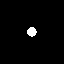
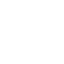

Epoch 500 , Loss 13.544119834899902


main channel,hidden channel

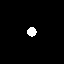
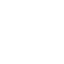

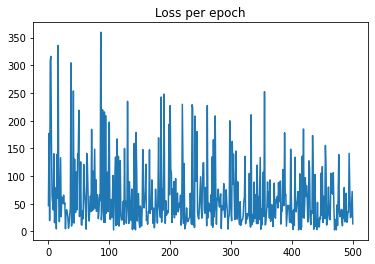

In [ ]:
model = NNA(n_channels)
dataset = dsDye

start_frame = 0
end_frame = 40
max_frame_steps = 10
extra_steps = 20

init = tf.convert_to_tensor(np.concatenate((dataset[start_frame],np.ones((1,64,64,hidden_channels))) , axis = -1))

#@title Dye : Loss frame + mask + rand init frame + 5 extra steps { vertical-output: true}
def train_step_frame_at_a_time(dataset):
    frame_steps = tf.random.uniform([],1,max_frame_steps,tf.int32)
    loss = 0
    random_frame_idx = np.random.randint(start_frame,end_frame-max_frame_steps)
    x = tf.convert_to_tensor(np.concatenate((dataset[random_frame_idx],np.ones((1,64,64,hidden_channels))) , axis = -1))
    with tf.GradientTape() as g:        
        for i in tf.range(frame_steps):
          for j in tf.range(extra_steps):
              x = model(x , mask= True)
        loss += loss_object(grayscale_m(dataset[random_frame_idx+frame_steps]), grayscale_m(x))
    gradients = g.gradient(loss, model.weights)
    gradients = [g / (tf.norm(g) + 1e-8) for g in gradients]
    optimizer.apply_gradients(zip(gradients, model.weights))
    return x, loss

EPOCHS = 501
losses = []
for epoch in range(EPOCHS):
    x, loss = train_step_frame_at_a_time(dataset)
    losses.append(loss)
    if epoch % 100 == 0:
      print(f'Epoch {epoch} , Loss {loss}')
      modelToGif(model, init ,500 , mask= True)

plt.plot(losses)
plt.title("Loss per epoch")
plt.show()

Epoch 0 , Loss 6.576236248016357


main channel,hidden channel

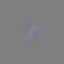
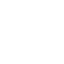

Epoch 100 , Loss 6.370872497558594


main channel,hidden channel

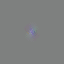
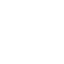

Epoch 200 , Loss 6.153902053833008


main channel,hidden channel

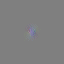
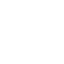

Epoch 300 , Loss 0.43550315499305725


main channel,hidden channel

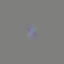
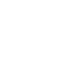

Epoch 400 , Loss 4.524641513824463


main channel,hidden channel

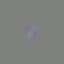
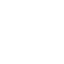

Epoch 500 , Loss 0.208103746175766


main channel,hidden channel

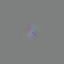
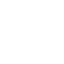

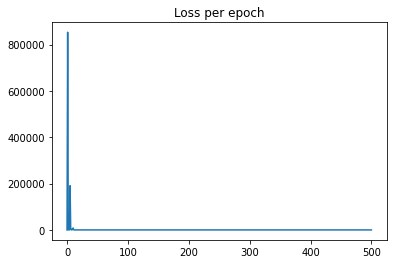

In [ ]:
model = NNA(6)

start_frame = 0
end_frame = 40
max_frame_steps = 5
extra_steps = 30

init = tf.convert_to_tensor(np.concatenate((dsVel[start_frame] , dsCurl[start_frame] ,np.ones((1,64,64,hidden_channels))) , axis = -1))

#@title Vel : Loss frame + rand init frame + 5 extra steps { vertical-output: true}
def train_step_frame_at_a_time():
    frame_steps = tf.random.uniform([],1,max_frame_steps,tf.int32)
    loss = 0
    random_frame_idx = np.random.randint(start_frame,end_frame-max_frame_steps)
    x = tf.convert_to_tensor(np.concatenate((dsVel[start_frame] , dsCurl[start_frame],np.ones((1,64,64,hidden_channels))) , axis = -1))
    with tf.GradientTape() as g:        
        for i in tf.range(frame_steps):
          for j in tf.range(extra_steps):
              x = model(x)
        loss += loss_object(np.concatenate((dsVel[random_frame_idx+frame_steps] , dsCurl[random_frame_idx+frame_steps]) , axis = -1), rgb_m(x)) * 100
    gradients = g.gradient(loss, model.weights)
    gradients = [g / (tf.norm(g) + 1e-8) for g in gradients]
    optimizer.apply_gradients(zip(gradients, model.weights))
    return x, loss

EPOCHS = 501
losses = []
for epoch in range(EPOCHS):
    x, loss = train_step_frame_at_a_time()
    losses.append(loss)
    if epoch % 100 == 0:
      print(f'Epoch {epoch} , Loss {loss}')
      _ = modelToGif(model, init ,500 , rgb= True)

plt.plot(losses)
plt.title("Loss per epoch")
plt.show()

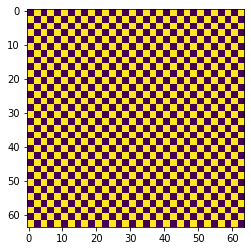

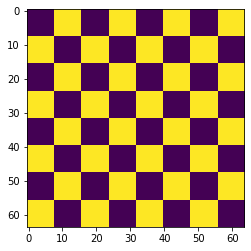

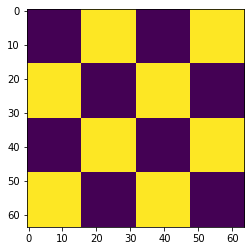

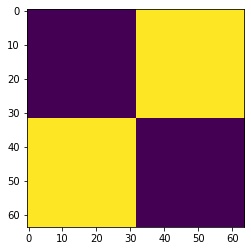

In [ ]:
#@title Position Emb { vertical-output: true}
def getPositionEmb(size):
  c = tf.math.ceil( tf.math.log(float(size)) / tf.math.log(2.0) )
  o = tf.expand_dims( 2**tf.range(c) , 1 )
  a = tf.expand_dims(tf.range(float(size)) , 0)
  pe = tf.math.floordiv( a , o ) % 2
  pe = tf.transpose(pe)
  pe = tf.repeat( [pe] , size , axis=0, name=None )
  pe = pe > 0
  pe = tf.math.logical_xor(pe,  tf.transpose(pe, [1, 0, 2]))
  pe = tf.expand_dims( pe , 0 )
  pe = tf.cast(pe, tf.float32)
  return pe

pe = getPositionEmb(64)

plt.imshow(pe[0,:,:,1])
plt.show()
plt.imshow(pe[0,:,:,3])
plt.show()
plt.imshow(pe[0,:,:,4])
plt.show()
plt.imshow(pe[0,:,:,5])
plt.show()



In [ ]:
#@title Initialize Training { vertical-output: true}
class NNA(tf.keras.Model):

    def __init__(self, n_channels_in , n_channels_out):
        super().__init__()
        self.channel_n = n_channels_in
        self.channel_out = n_channels_out

        self.alpha = alpha

        self.dmodel = tf.keras.Sequential([
            tf.keras.layers.Conv2D(128, 1, activation=tf.nn.relu),
            tf.keras.layers.Conv2D(self.channel_out, 1, activation=None, kernel_initializer=tf.zeros_initializer)
        ])
        self(tf.zeros([1, 3, 3, self.channel_n]),tf.zeros([1, 3, 3, self.channel_out]))

    def perceive(self, x):
        cellID = tf.constant([[0., 0., 0.], [0., 1., 0.], [0., 0., 0.]], dtype=tf.float32)
        sobelX = tf.constant([[-1., 0., 1.], [-2., 0., 2.], [-1., 0., 1.]], dtype=tf.float32)
        sobelY = tf.constant([[-1., -2., -1.], [0., 0., 0.], [1., 2., 1.]], dtype=tf.float32)

        kernel = tf.stack([cellID, sobelX, sobelY], -1)[:, :, None, :]
        kernel = tf.repeat(kernel, self.channel_n, 2)

        y = tf.nn.depthwise_conv2d(x, kernel, [1, 1, 1, 1], 'SAME')
        return y

    def call(self, x , x1 , steps = 1 , mask = False):
        x = tf.cast(x ,  tf.float32)
        x1 = tf.cast(x1 ,  tf.float32)
        if mask:
          pre_live_mask = get_living_mask(x)

        y = self.perceive(x)
        dx = self.dmodel(y) * steps

        update_mask = tf.random.uniform(tf.shape(x[:, :, :, :1])) <= 0.5
        x1 += dx * tf.cast(update_mask, tf.float32)

        if mask:
          post_life_mask = get_living_mask(x1)
          life_mask = pre_live_mask | post_life_mask
          life_mask = mask_edges(life_mask)
          return x1 * tf.cast(life_mask, tf.float32)

        return x1
        
# TODO: is this a mistake?
model = NNA(n_channels , n_channels)
model.summary()

Model: "nna_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_1 (Sequential)   (1, 3, 3, 4)              2180      
                                                                 
Total params: 2,180
Trainable params: 2,180
Non-trainable params: 0
_________________________________________________________________


Epoch 0 , Loss 84.894287109375


main channel,hidden channel

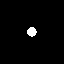
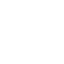

Epoch 100 , Loss 104.30230712890625


main channel,hidden channel

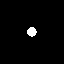
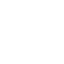

Epoch 200 , Loss 33.0273323059082


main channel,hidden channel

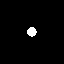
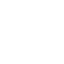

Epoch 300 , Loss 125.8523178100586


main channel,hidden channel

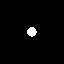
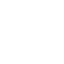

Epoch 400 , Loss 7.51069450378418


main channel,hidden channel

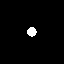
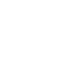

Epoch 500 , Loss 2.994688034057617


main channel,hidden channel

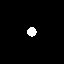
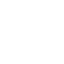

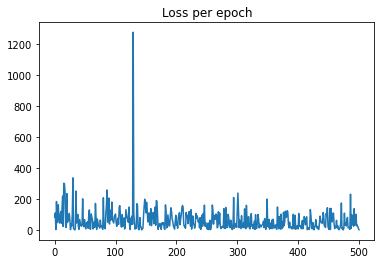

In [ ]:
model = NNA(n_channels + 6 , n_channels)
dataset = dsDye

start_frame = 0
end_frame = 40
max_frame_steps = 10
extra_steps = 20

pos_emb = getPositionEmb(64)
init = tf.convert_to_tensor(np.concatenate((dataset[start_frame],np.ones((1,64,64,hidden_channels))) , axis = -1))

#@title Dye : Loss frame + rand init frame + 5 extra steps + position encoding { vertical-output: true}
def train_step_frame_at_a_time(dataset):
    frame_steps = tf.random.uniform([],1,max_frame_steps,tf.int32)
    loss = 0
    random_frame_idx = np.random.randint(start_frame,end_frame-max_frame_steps)
    x = tf.cast(tf.convert_to_tensor(np.concatenate((dataset[random_frame_idx],np.ones((1,64,64,hidden_channels))) , axis = -1)),tf.float32)
    with tf.GradientTape() as g:        
        for i in tf.range(frame_steps):
          for j in tf.range(extra_steps):
              x_emb = tf.concat([x , pos_emb],-1)
              x = model( x_emb , x )
        loss += loss_object(grayscale_m(dataset[random_frame_idx+frame_steps]), grayscale_m(x))
    gradients = g.gradient(loss, model.weights)
    gradients = [g / (tf.norm(g) + 1e-8) for g in gradients]
    optimizer.apply_gradients(zip(gradients, model.weights))
    return x, loss

EPOCHS = 501
losses = []
for epoch in range(EPOCHS):
    x, loss = train_step_frame_at_a_time(dataset)
    losses.append(loss)
    if epoch % 100 == 0:
      print(f'Epoch {epoch} , Loss {loss}')
      modelToGif(model, init ,500 , emb = pos_emb)

plt.plot(losses)
plt.title("Loss per epoch")
plt.show()

Epoch 0 , Loss 210.4091796875


main channel,hidden channel

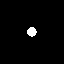
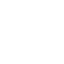

Epoch 500 , Loss 32.829952239990234


main channel,hidden channel

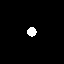
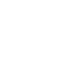

Epoch 1000 , Loss 32.64205551147461


main channel,hidden channel

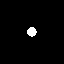
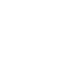

Epoch 1500 , Loss 35.487030029296875


main channel,hidden channel

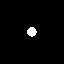
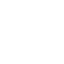

Epoch 2000 , Loss 16.656085968017578


main channel,hidden channel

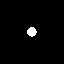
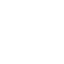

Epoch 2500 , Loss 24.56174659729004


main channel,hidden channel

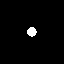
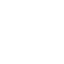

In [ ]:
model = NNA(n_channels + 6 , n_channels)
dataset = dsDye

alpha= 0.1

start_frame = 0
end_frame = 40
max_frame_steps = 10
extra_steps = 20

pos_emb = getPositionEmb(64)
init = tf.convert_to_tensor(np.concatenate((dataset[start_frame],np.ones((1,64,64,hidden_channels))) , axis = -1))

#@title Dye : Loss frame + rand init frame + 5 extra steps + position encoding + mask { vertical-output: true}
def train_step_frame_at_a_time(dataset):
    frame_steps = tf.random.uniform([],1,max_frame_steps,tf.int32)
    loss = 0
    random_frame_idx = np.random.randint(start_frame,end_frame-max_frame_steps)
    x = tf.cast(tf.convert_to_tensor(np.concatenate((dataset[random_frame_idx],np.ones((1,64,64,hidden_channels))) , axis = -1)),tf.float32)
    with tf.GradientTape() as g:        
        for i in tf.range(frame_steps):
          for j in tf.range(extra_steps):
              x_emb = tf.concat([x , pos_emb],-1)
              x = model( x_emb , x , mask=True)
        loss += loss_object(grayscale_m(dataset[random_frame_idx+frame_steps]), grayscale_m(x))
    gradients = g.gradient(loss, model.weights)
    gradients = [g / (tf.norm(g) + 1e-8) for g in gradients]
    optimizer.apply_gradients(zip(gradients, model.weights))
    return x, loss

EPOCHS = 10001
losses = []
for epoch in range(EPOCHS):
    x, loss = train_step_frame_at_a_time(dataset)
    losses.append(loss)
    if epoch % 500 == 0:
      print(f'Epoch {epoch} , Loss {loss}')
      modelToGif(model, init ,500 , emb = pos_emb , fps=18, mask=True)

plt.plot(losses)
plt.title("Loss per epoch")
plt.show()



*   fix mask to remove grid noise (change alpha)
*   dont use uniform random to pick init state (gradually take longer run)
*   try with a bouncy falling square
*   add obstacles (place constant cells in image)
*   compute loss with mask
*   train model from actual video sim


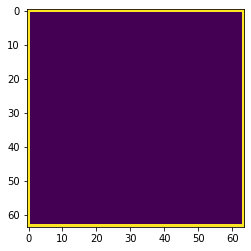

In [ ]:
#@title Border Channel  { vertical-output: true}
def getBorder(size):
  b = np.ones((size,size))
  b = np.expand_dims(b,0)
  b = np.expand_dims(b,3)
  b[0,1:-1,1:-1,0] = 0
  return tf.convert_to_tensor(b)

pe = getBorder(64)

plt.imshow(pe[0,:,:,0])
plt.show()

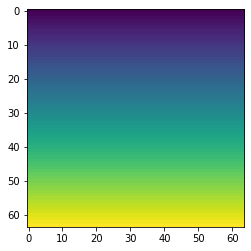

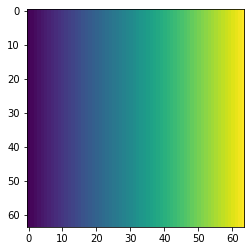

In [ ]:
#@title Position Absolute Encoding  { vertical-output: true}
def getPositionEmb2(size):
  l = np.linspace(0, 1, num=size)
  pe_x = np.repeat(l, size, 0)
  pe_x = np.reshape(pe_x, (size, size))
  pe_y = pe_x.T

  pe = np.zeros((1,size,size,2))
  pe[0,:,:,0] = pe_x
  pe[0,:,:,1] = pe_y
  return tf.convert_to_tensor(pe)

pe = getPositionEmb2(64)

plt.imshow(pe[0,:,:,0])
plt.show()
plt.imshow(pe[0,:,:,1])
plt.show()

In [ ]:
model = NNA(n_channels + 2 , n_channels)
dataset = dsDye

alpha= 0.1

start_frame = 0
end_frame = 40
max_frame_steps = 10
extra_steps = 20

pos_emb = getPositionEmb2(64)
init = tf.convert_to_tensor(np.concatenate((dataset[start_frame],np.ones((1,64,64,hidden_channels))) , axis = -1))

#@title Dye : Loss frame + rand init frame + 5 extra steps + absolute position encoding + mask { vertical-output: true}
def train_step_frame_at_a_time(dataset):
    frame_steps = tf.random.uniform([],1,max_frame_steps,tf.int32)
    loss = 0
    random_frame_idx = np.random.randint(start_frame,end_frame-max_frame_steps)
    x = tf.cast(tf.convert_to_tensor(np.concatenate((dataset[random_frame_idx],np.ones((1,64,64,hidden_channels))) , axis = -1)),tf.float32)
    with tf.GradientTape() as g:        
        for i in tf.range(frame_steps):
          for j in tf.range(extra_steps):
              x_emb = tf.concat([x , pos_emb],-1)
              x = model( x_emb , x , mask=True)
        loss += loss_object(grayscale_m(dataset[random_frame_idx+frame_steps]), grayscale_m(x))
    gradients = g.gradient(loss, model.weights)
    gradients = [g / (tf.norm(g) + 1e-8) for g in gradients]
    optimizer.apply_gradients(zip(gradients, model.weights))
    return x, loss

EPOCHS = 10001
losses = []
for epoch in range(EPOCHS):
    x, loss = train_step_frame_at_a_time(dataset)
    losses.append(loss)
    if epoch % 500 == 0:
      print(f'Epoch {epoch} , Loss {loss}')
      modelToGif(model, init ,500 , emb = pos_emb , fps=18, mask=True)

plt.plot(losses)
plt.title("Loss per epoch")
plt.show()

TypeError: ignored

In [ ]:
model = NNA(n_channels + 3 , n_channels)
dataset = dsDye

alpha= 0.1

start_frame = 0
end_frame = 40
max_frame_steps = 10
extra_steps = 20

pos_emb = getPositionEmb2(64)
border = getBorder(64)
init = tf.convert_to_tensor(np.concatenate((dataset[start_frame],np.ones((1,64,64,hidden_channels))) , axis = -1))

#@title Dye : Loss frame + rand init frame + 5 extra steps + absolute position encoding + border + mask { vertical-output: true}
def train_step_frame_at_a_time(dataset):
    frame_steps = tf.random.uniform([],1,max_frame_steps,tf.int32)
    loss = 0
    random_frame_idx = np.random.randint(start_frame,end_frame-max_frame_steps)
    x = tf.cast(tf.convert_to_tensor(np.concatenate((dataset[random_frame_idx],np.ones((1,64,64,hidden_channels))) , axis = -1)),tf.float32)
    with tf.GradientTape() as g:        
        for i in tf.range(frame_steps):
          for j in tf.range(extra_steps):
              x_emb = tf.concat([x , pos_emb, border],-1)
              x = model( x_emb , x , mask=True)
        loss += loss_object(grayscale_m(dataset[random_frame_idx+frame_steps]), grayscale_m(x))
    gradients = g.gradient(loss, model.weights)
    gradients = [g / (tf.norm(g) + 1e-8) for g in gradients]
    optimizer.apply_gradients(zip(gradients, model.weights))
    return x, loss

EPOCHS = 10001
losses = []
for epoch in range(EPOCHS):
    x, loss = train_step_frame_at_a_time(dataset)
    losses.append(loss)
    if epoch % 500 == 0:
      print(f'Epoch {epoch} , Loss {loss}')
      modelToGif(model, init ,500 , emb = pos_emb , fps=18, mask=True)

plt.plot(losses)
plt.title("Loss per epoch")
plt.show()